<a href="https://colab.research.google.com/github/difyousra/augmented-reality/blob/main/recognition_mat_car.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Install Git if not already installed
!apt-get install git

# Set up your Git configuration (replace with your GitHub details)
!git config --global user.name "difyousra"
!git config --global user.email "difyousrakh@gmail.com"

# Initialize a new Git repository
!git init

# Add your new GitHub repository as a remote
!git remote add origin https://github.com/difyousra/AT-hackathon.git


In [1]:
# Cellule 1: Installation des Bibliothèques Nécessaires
!pip install ultralytics supervision easyocr filterpy scipy pillow


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.0/178.0 kB 13.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 901.3/901.3 kB 22.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 181.5/181.5 kB 10.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 38.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 422.9/422.9 kB 24.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 912.2/912.2 kB 34.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 286.8/286.8 kB 20.3 MB/s eta 0:00:00
  Created wheel for filterpy: filename=filterpy-1.4.5-py3-none-any.whl size=110458 sha256=9703740b6866b2ac2298eecf53ca4c773cdc0dba44331548b024307f11d21028
  Stored in directory: /root/.cache/pip/wheels/0f/0c/ea/218f266af4ad626897562199fbbcba521b8497303200186102
Successfully built filterpy


In [ ]:
# Cellule 2: Montage de Google Drive
from google.colab import drive
drive.mount('/content/drive')



Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Cellule 4: Définition de la Classe KalmanBoxTracker
class KalmanBoxTracker:
    """
    Classe pour le suivi des objets avec un filtre de Kalman.
    """
    count = 0

    def __init__(self, bbox):
        """
        Initialise un nouveau traqueur avec une bounding box initiale.

        Args:
            bbox (list ou tuple): Bounding box initiale [x1, y1, x2, y2].
        """
        self.id = KalmanBoxTracker.count
        KalmanBoxTracker.count += 1
        self.kf = KalmanFilter(dim_x=7, dim_z=4)
        self.kf.F = np.array([
            [1, 0, 0, 0, 1, 0, 0],
            [0, 1, 0, 0, 0, 1, 0],
            [0, 0, 1, 0, 0, 0, 1],
            [0, 0, 0, 1, 0, 0, 0],
            [0, 0, 0, 0, 1, 0, 0],
            [0, 0, 0, 0, 0, 1, 0],
            [0, 0, 0, 0, 0, 0, 1]
        ])
        self.kf.H = np.array([
            [1, 0, 0, 0, 0, 0, 0],
            [0, 1, 0, 0, 0, 0, 0],
            [0, 0, 1, 0, 0, 0, 0],
            [0, 0, 0, 1, 0, 0, 0]
        ])
        self.kf.R[2:, 2:] *= 10.
        self.kf.P[4:, 4:] *= 1000.
        self.kf.P *= 10.
        self.kf.Q[-1, -1] *= 0.01
        self.kf.Q[4:, 4:] *= 0.01
        self.kf.x[:4] = np.array(bbox[:4]).reshape((4, 1))
        self.time_since_update = 0
        self.history = []
        self.hits = 0
        self.hit_streak = 0
        self.age = 0

    def update(self, bbox):
        """
        Met à jour le filtre de Kalman avec de nouvelles observations.

        Args:
            bbox (list ou tuple): Nouvelle bounding box [x1, y1, x2, y2].
        """
        self.time_since_update = 0
        self.history = []
        self.hits += 1
        self.hit_streak += 1
        self.kf.update(np.array(bbox).reshape((4, 1)))

    def predict(self):
        """
        Prédit l'état futur de l'objet.

        Returns:
            np.ndarray: Etat prédit [x, y, s, r, ...].
        """
        if (self.kf.x[6] + self.kf.x[2]) <= 0:
            self.kf.x[6] = 0
        self.kf.predict()
        self.age += 1
        if self.time_since_update > 0:
            self.hit_streak = 0
        self.time_since_update += 1
        self.history.append(self.kf.x.copy())
        return self.history[-1]

    def get_state(self):
        """
        Obtient l'état actuel du traqueur.

        Returns:
            np.ndarray: Bounding box actuelle [x1, y1, x2, y2].
        """
        return self.kf.x[:4].reshape((1, 4))


In [ ]:
# Étape 1 : Installer les bibliothèques nécessaires
!pip install ultralytics supervision opencv-python-headless filterpy easyocr


Nombre total de frames : 631
FPS : 30
Frames à traiter : 30

0: 416x640 2 cars, 20.6ms
Speed: 3.7ms preprocess, 20.6ms inference, 7.3ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 31.0ms
Speed: 3.3ms preprocess, 31.0ms inference, 14.6ms postprocess per image at shape (1, 3, 416, 640)


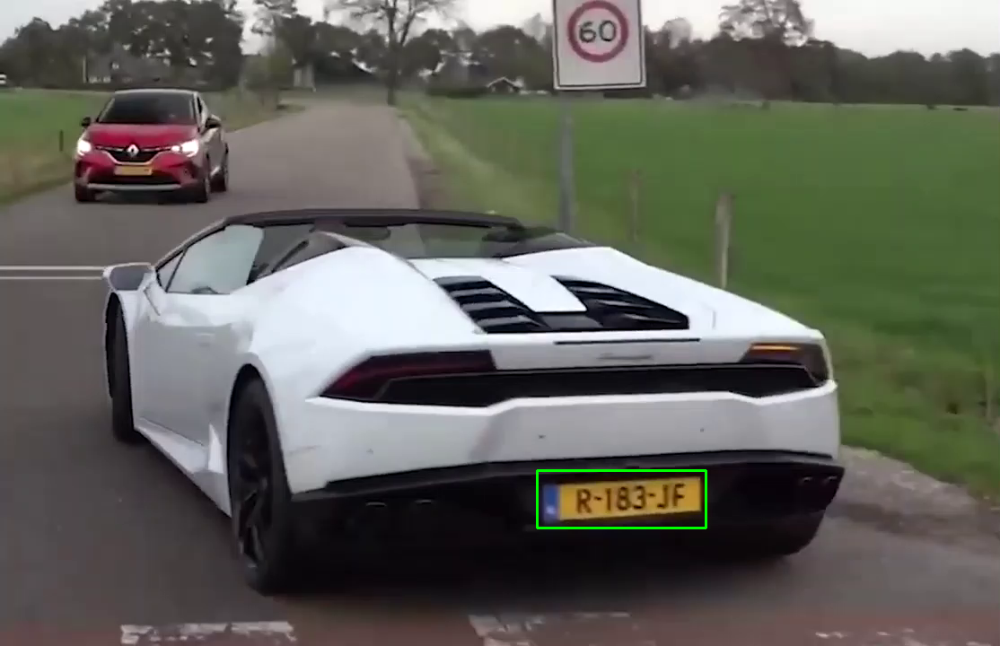


0: 416x640 2 cars, 12.9ms
Speed: 3.3ms preprocess, 12.9ms inference, 2.8ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 26.3ms
Speed: 6.3ms preprocess, 26.3ms inference, 7.3ms postprocess per image at shape (1, 3, 416, 640)


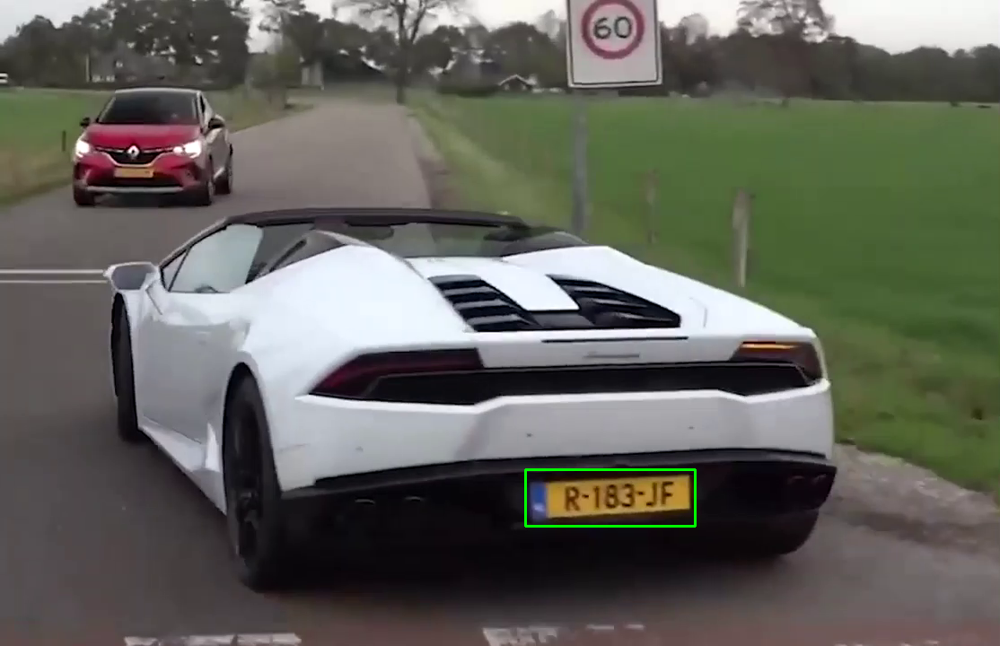


0: 416x640 2 cars, 16.0ms
Speed: 12.5ms preprocess, 16.0ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 35.2ms
Speed: 3.3ms preprocess, 35.2ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 640)


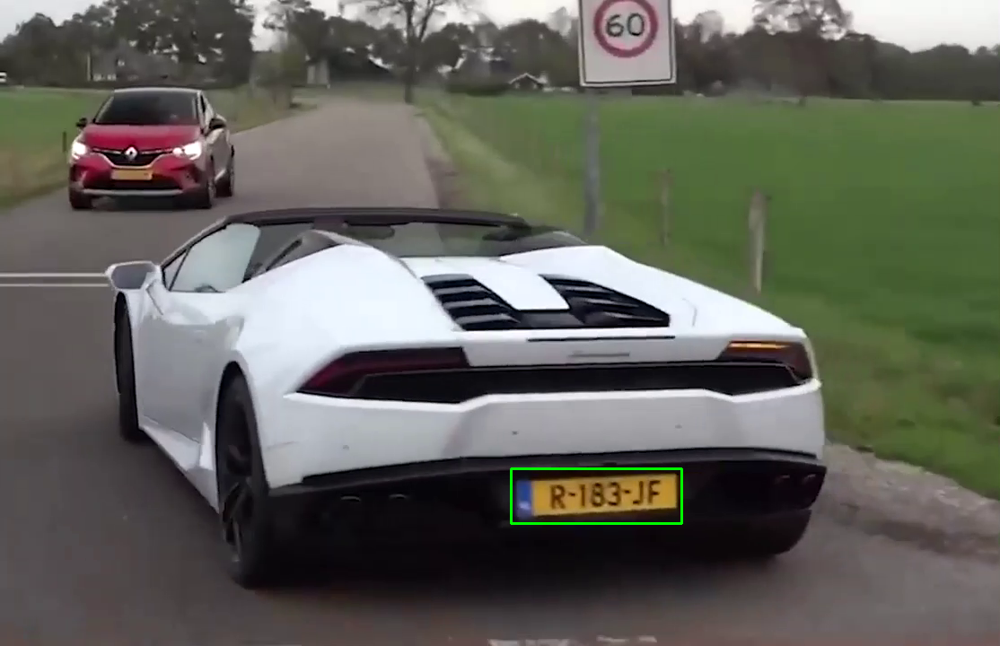


0: 416x640 2 cars, 44.7ms
Speed: 17.5ms preprocess, 44.7ms inference, 5.5ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 21.0ms
Speed: 5.8ms preprocess, 21.0ms inference, 11.1ms postprocess per image at shape (1, 3, 416, 640)


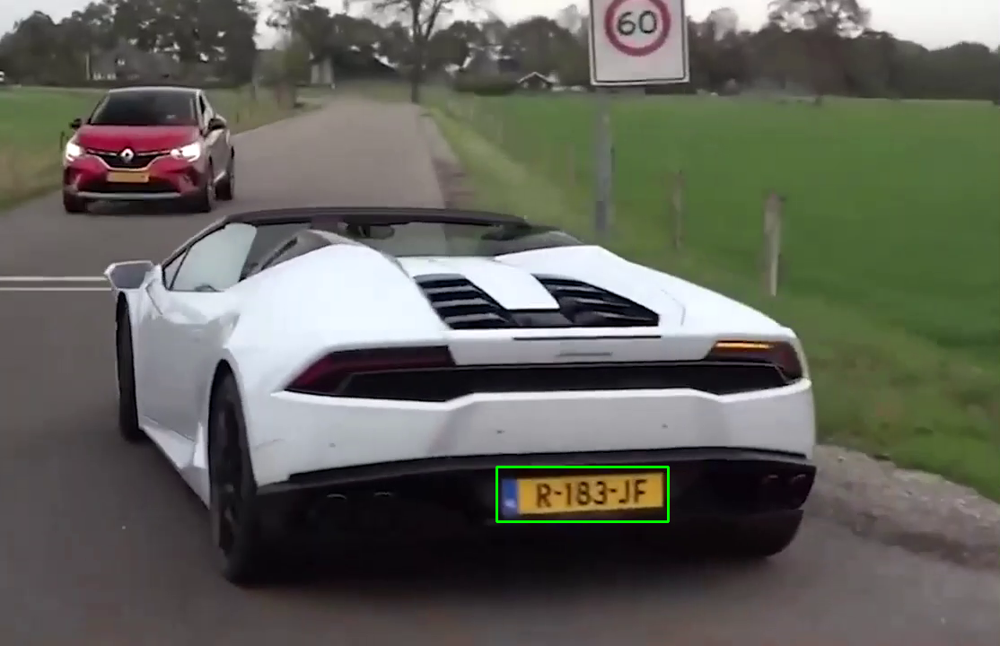


0: 416x640 2 cars, 13.0ms
Speed: 3.4ms preprocess, 13.0ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 18.0ms
Speed: 3.8ms preprocess, 18.0ms inference, 9.0ms postprocess per image at shape (1, 3, 416, 640)


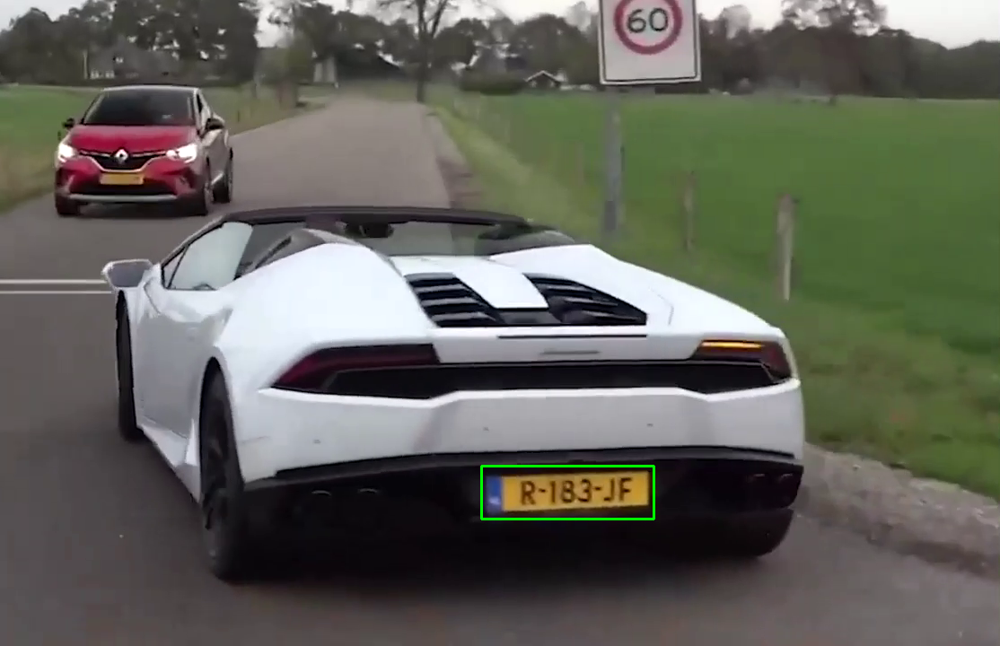


0: 416x640 2 cars, 74.1ms
Speed: 11.0ms preprocess, 74.1ms inference, 11.7ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 78.9ms
Speed: 9.6ms preprocess, 78.9ms inference, 13.2ms postprocess per image at shape (1, 3, 416, 640)


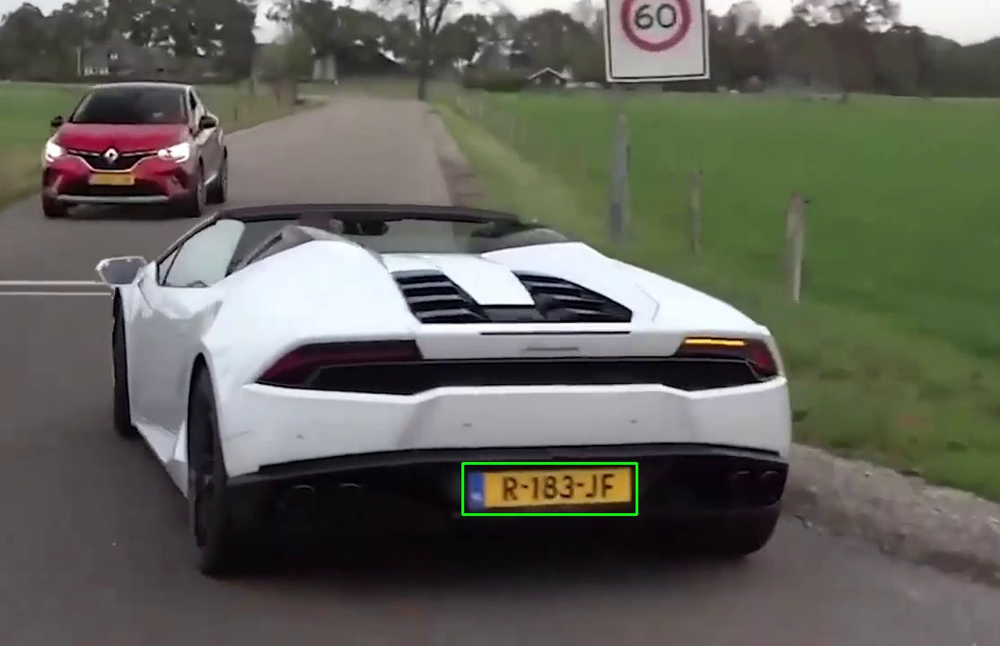


0: 416x640 2 cars, 21.7ms
Speed: 7.9ms preprocess, 21.7ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 12.4ms
Speed: 3.3ms preprocess, 12.4ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 640)


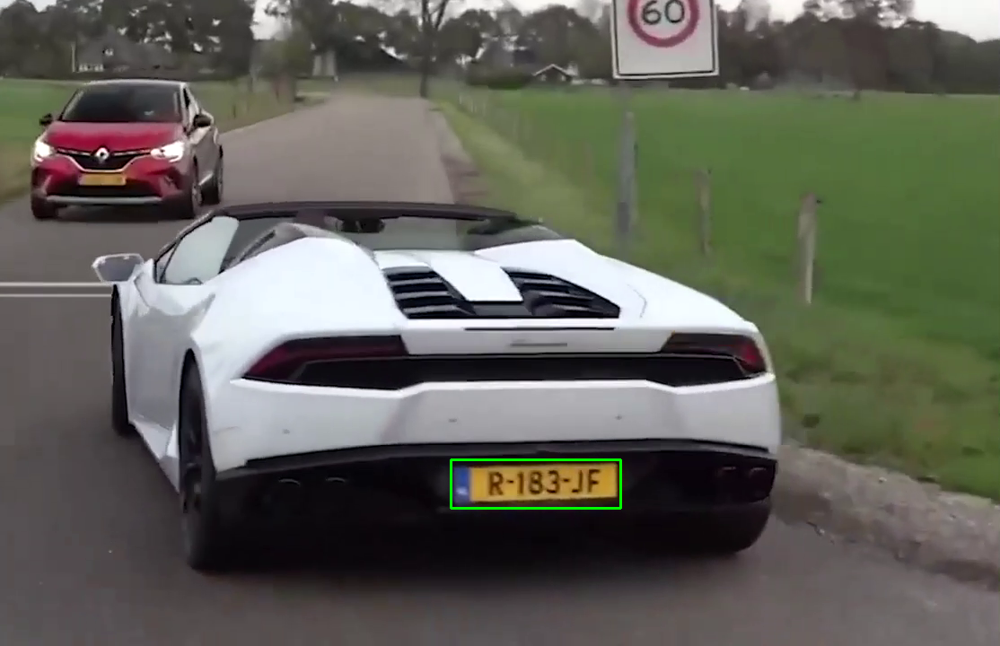


0: 416x640 2 cars, 43.3ms
Speed: 18.0ms preprocess, 43.3ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 12.5ms
Speed: 3.5ms preprocess, 12.5ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 640)


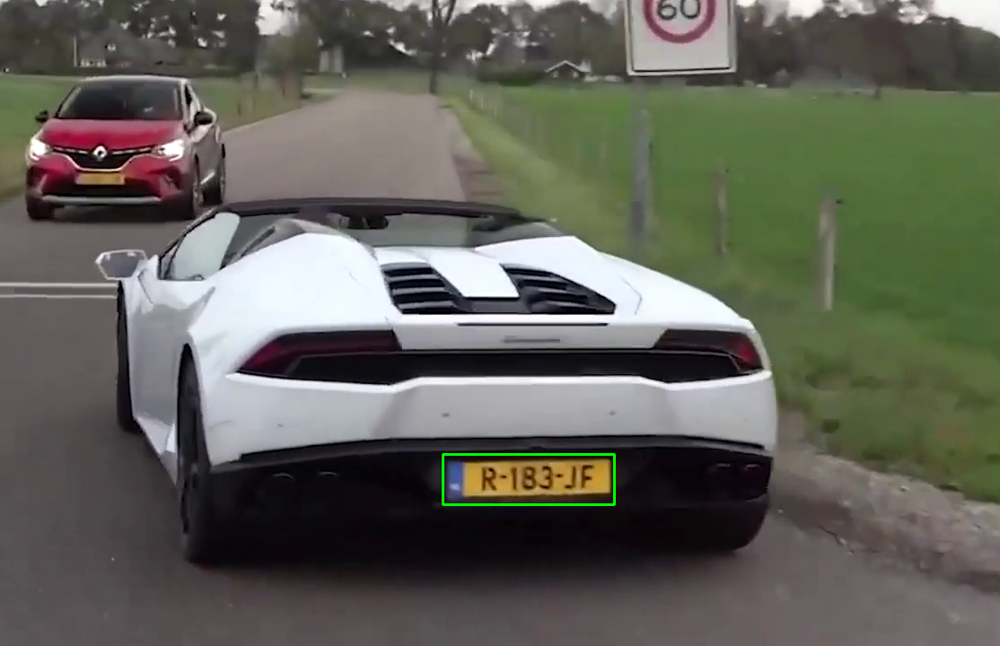


0: 416x640 2 cars, 32.7ms
Speed: 11.5ms preprocess, 32.7ms inference, 3.0ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 12.5ms
Speed: 3.3ms preprocess, 12.5ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)


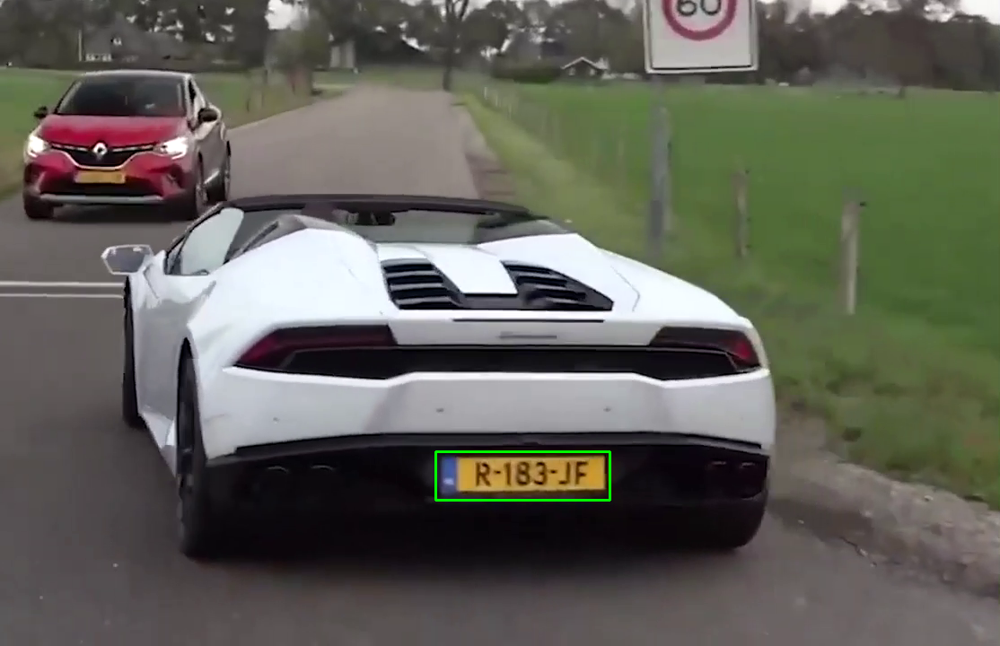


0: 416x640 2 cars, 86.3ms
Speed: 3.3ms preprocess, 86.3ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 72.6ms
Speed: 16.4ms preprocess, 72.6ms inference, 12.8ms postprocess per image at shape (1, 3, 416, 640)


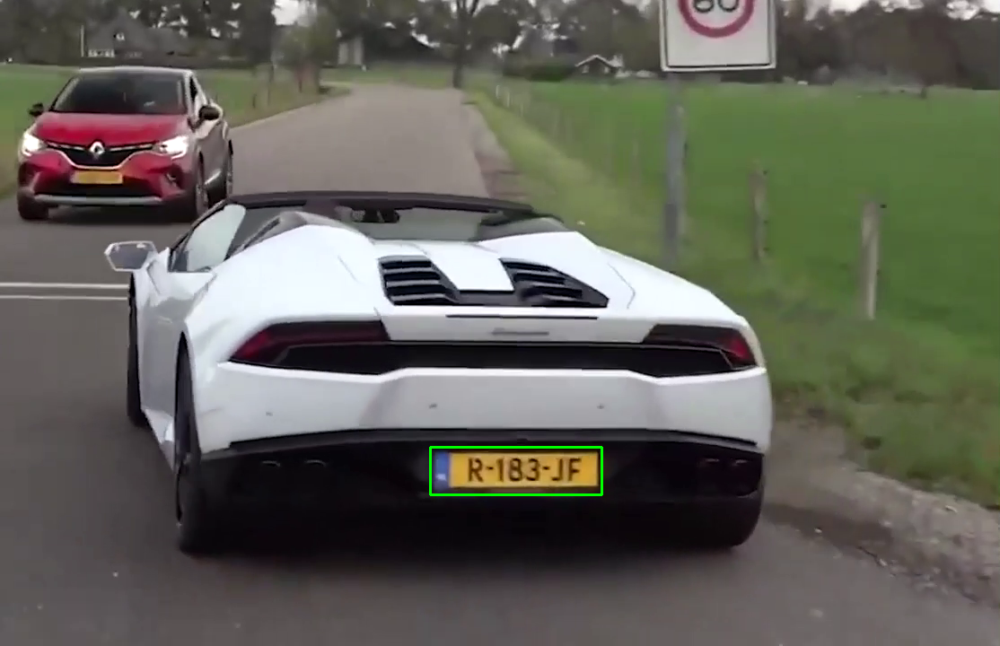


0: 416x640 2 cars, 27.1ms
Speed: 4.4ms preprocess, 27.1ms inference, 5.0ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 48.5ms
Speed: 3.8ms preprocess, 48.5ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)


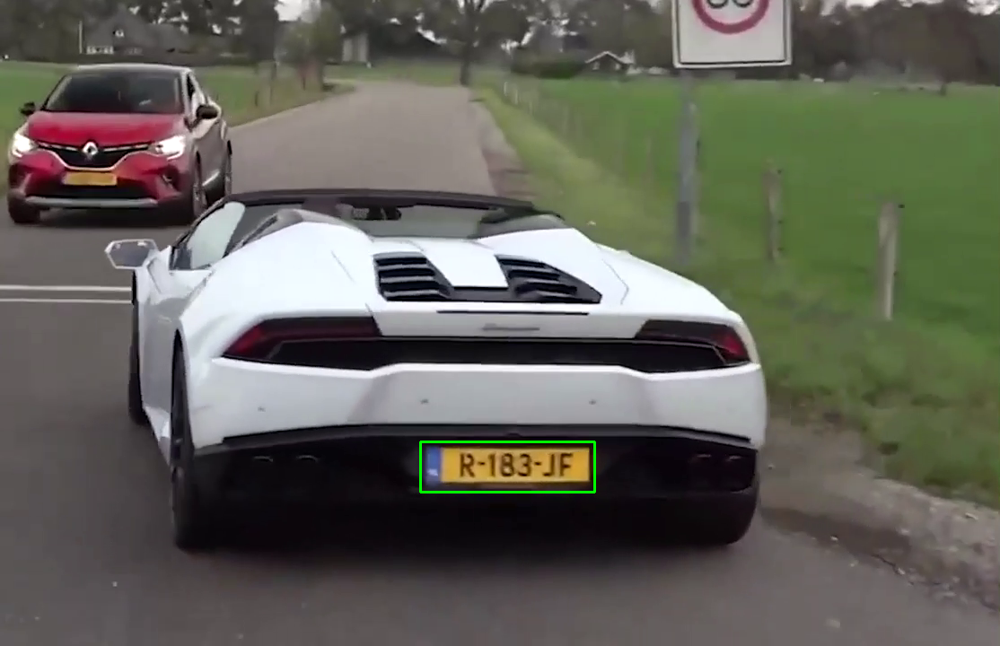


0: 416x640 2 cars, 25.8ms
Speed: 3.5ms preprocess, 25.8ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 49.4ms
Speed: 3.3ms preprocess, 49.4ms inference, 2.5ms postprocess per image at shape (1, 3, 416, 640)


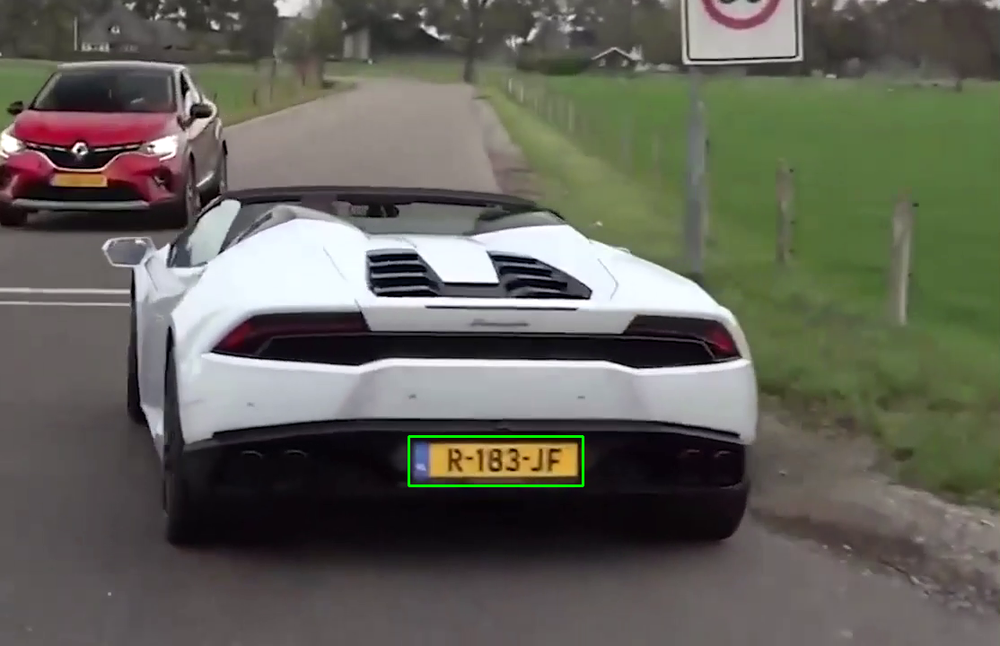


0: 416x640 3 cars, 66.1ms
Speed: 26.6ms preprocess, 66.1ms inference, 10.3ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 15.6ms
Speed: 4.6ms preprocess, 15.6ms inference, 10.3ms postprocess per image at shape (1, 3, 416, 640)


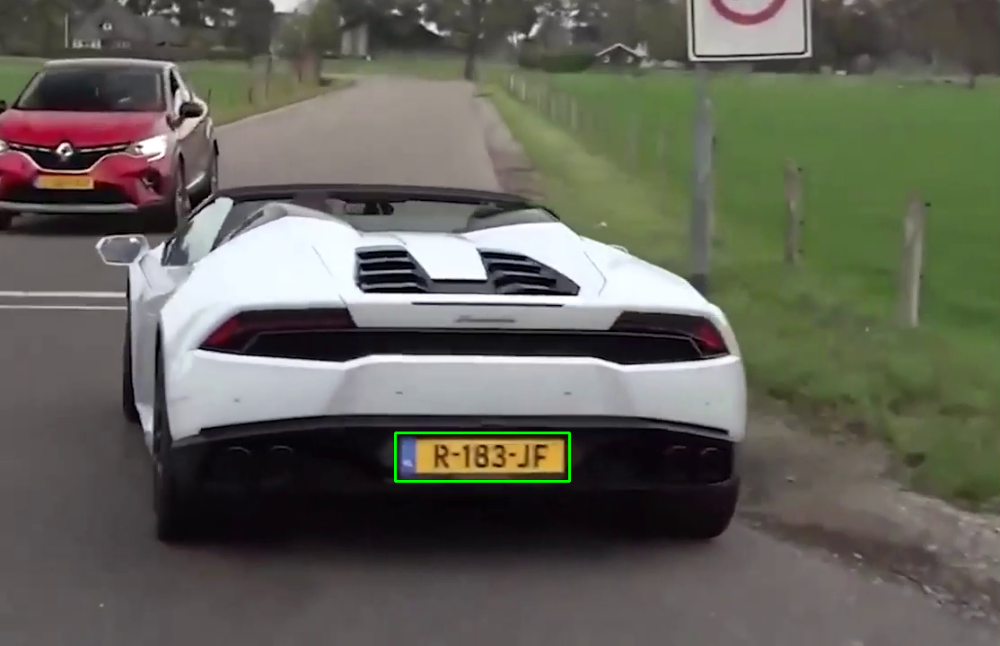


0: 416x640 2 cars, 36.2ms
Speed: 7.6ms preprocess, 36.2ms inference, 6.0ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 36.1ms
Speed: 9.3ms preprocess, 36.1ms inference, 12.2ms postprocess per image at shape (1, 3, 416, 640)


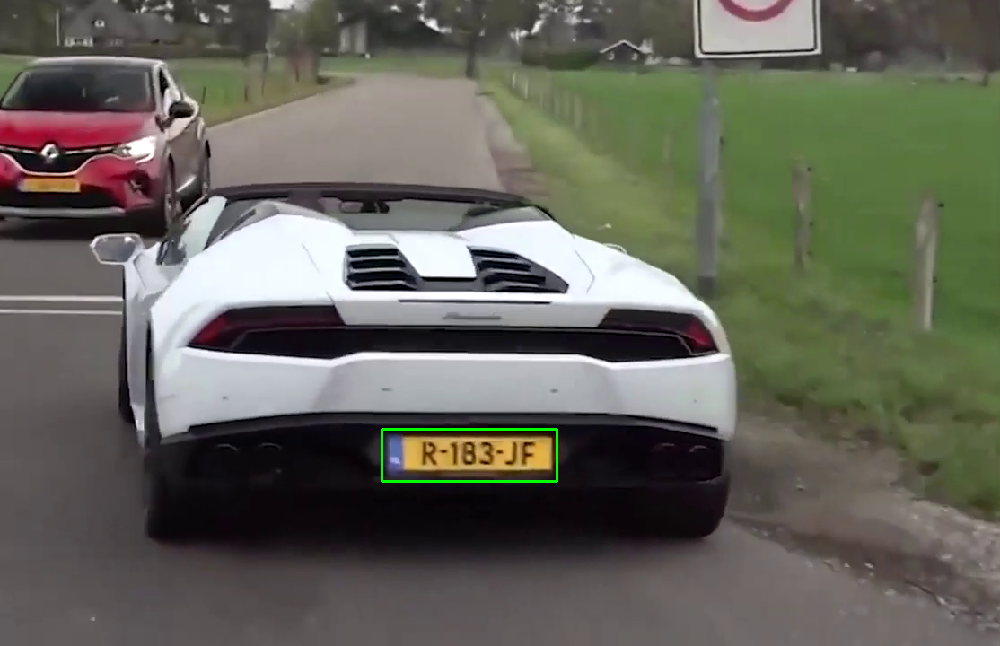


0: 416x640 2 cars, 20.0ms
Speed: 4.6ms preprocess, 20.0ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 28.4ms
Speed: 9.3ms preprocess, 28.4ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)


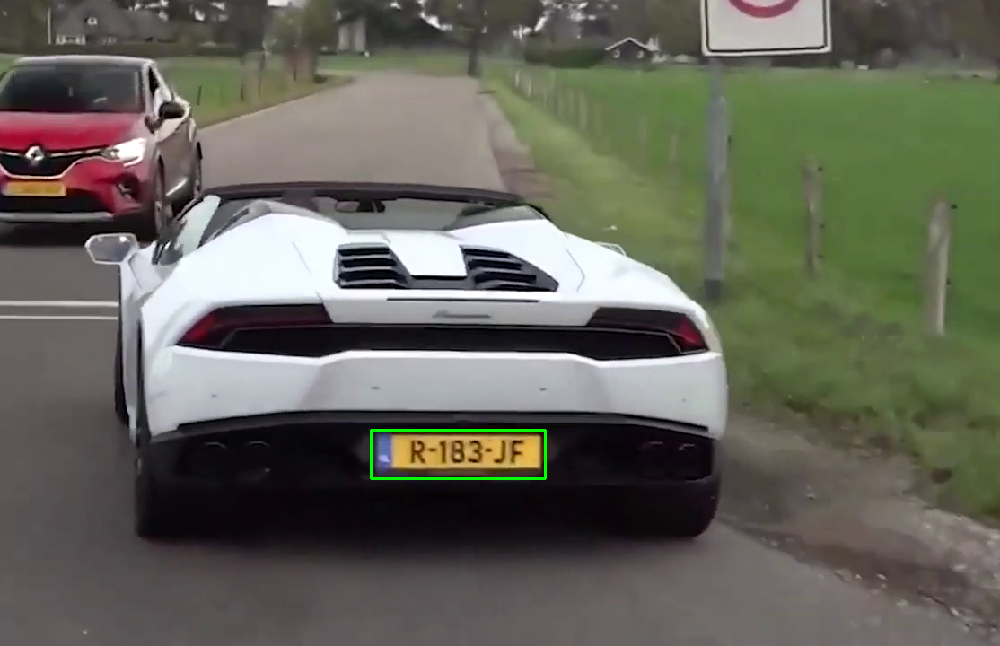


0: 416x640 2 cars, 21.2ms
Speed: 3.3ms preprocess, 21.2ms inference, 4.7ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 24.0ms
Speed: 3.3ms preprocess, 24.0ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)


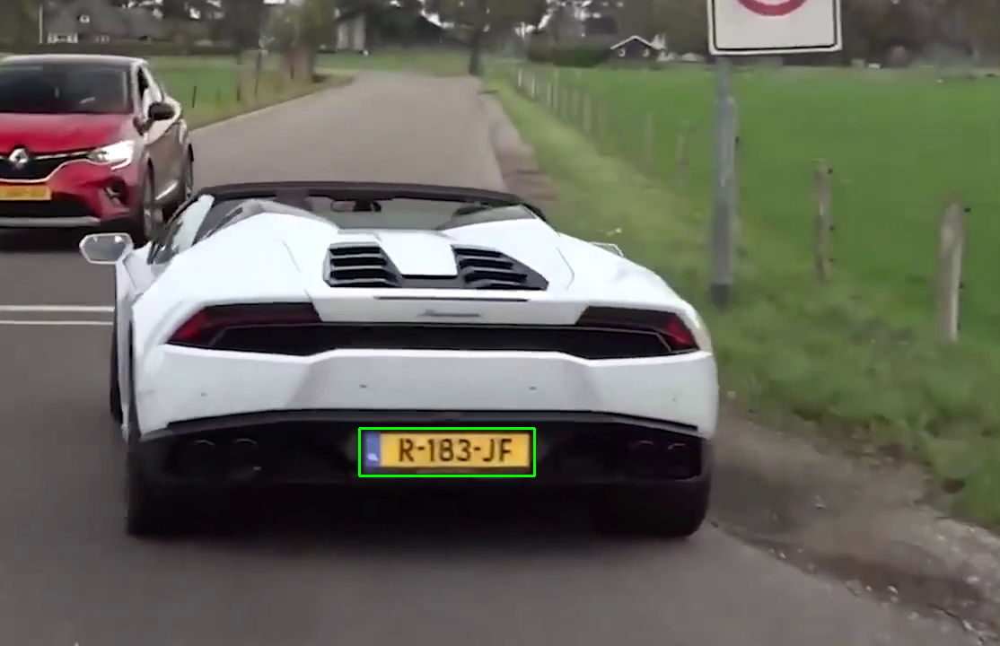


0: 416x640 2 cars, 22.1ms
Speed: 7.8ms preprocess, 22.1ms inference, 6.8ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 20.9ms
Speed: 6.7ms preprocess, 20.9ms inference, 4.8ms postprocess per image at shape (1, 3, 416, 640)


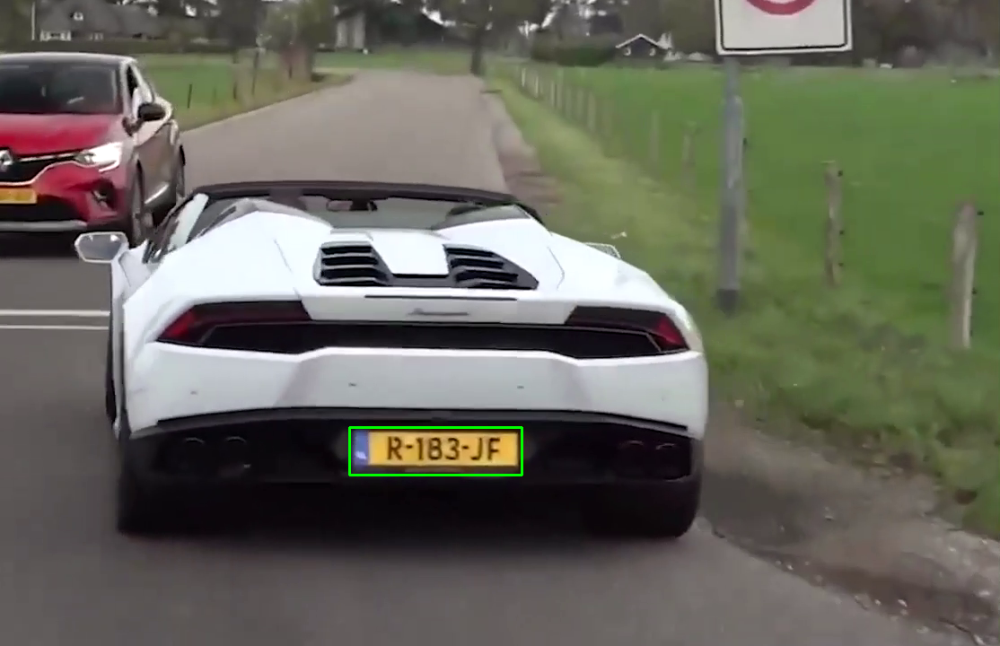


0: 416x640 2 cars, 32.6ms
Speed: 4.4ms preprocess, 32.6ms inference, 4.2ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 24.9ms
Speed: 6.8ms preprocess, 24.9ms inference, 6.1ms postprocess per image at shape (1, 3, 416, 640)


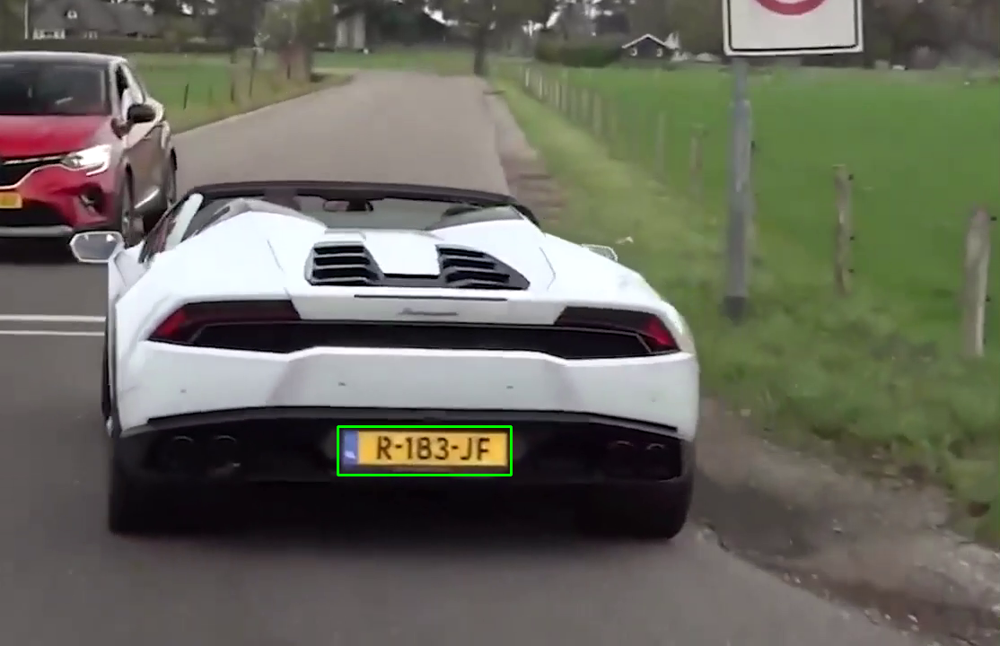


0: 416x640 2 cars, 31.2ms
Speed: 5.9ms preprocess, 31.2ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 38.4ms
Speed: 16.1ms preprocess, 38.4ms inference, 8.7ms postprocess per image at shape (1, 3, 416, 640)


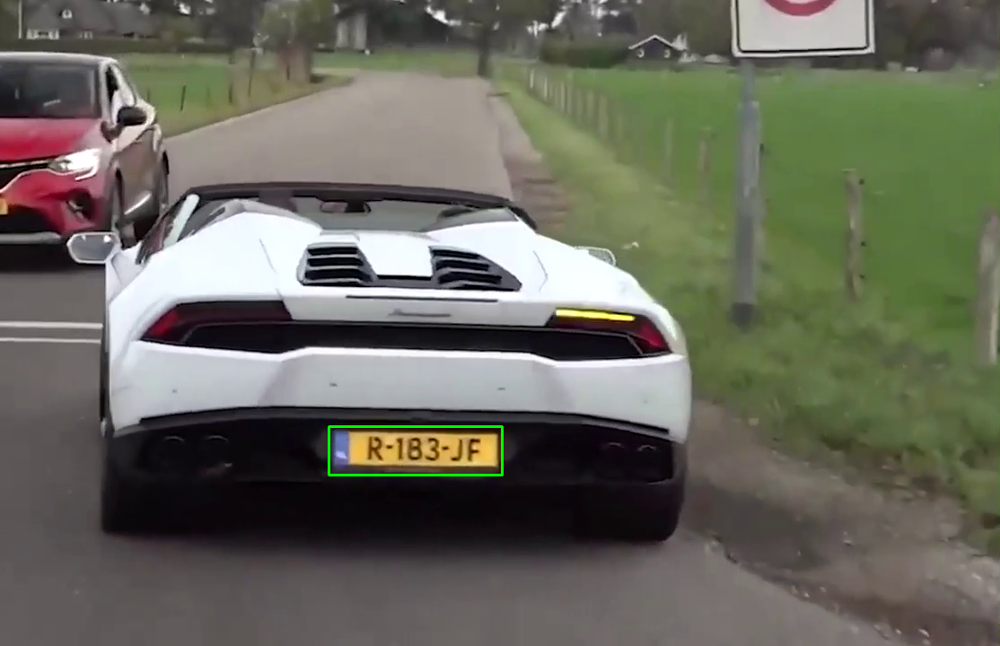


0: 416x640 2 cars, 36.6ms
Speed: 8.5ms preprocess, 36.6ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 33.1ms
Speed: 5.5ms preprocess, 33.1ms inference, 5.9ms postprocess per image at shape (1, 3, 416, 640)


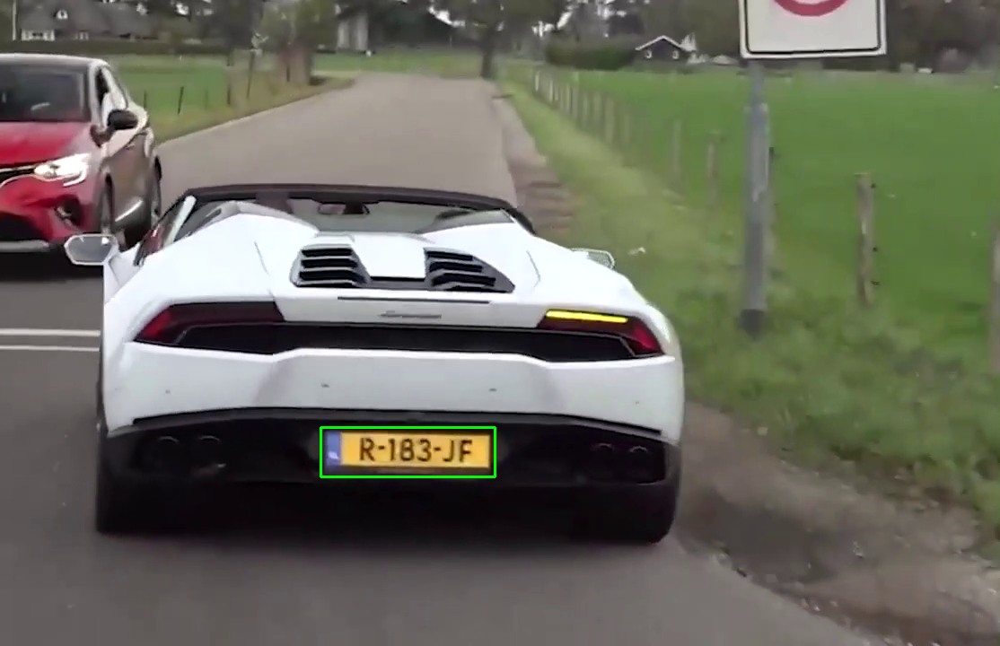


0: 416x640 2 cars, 58.0ms
Speed: 10.0ms preprocess, 58.0ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 28.6ms
Speed: 20.4ms preprocess, 28.6ms inference, 9.8ms postprocess per image at shape (1, 3, 416, 640)


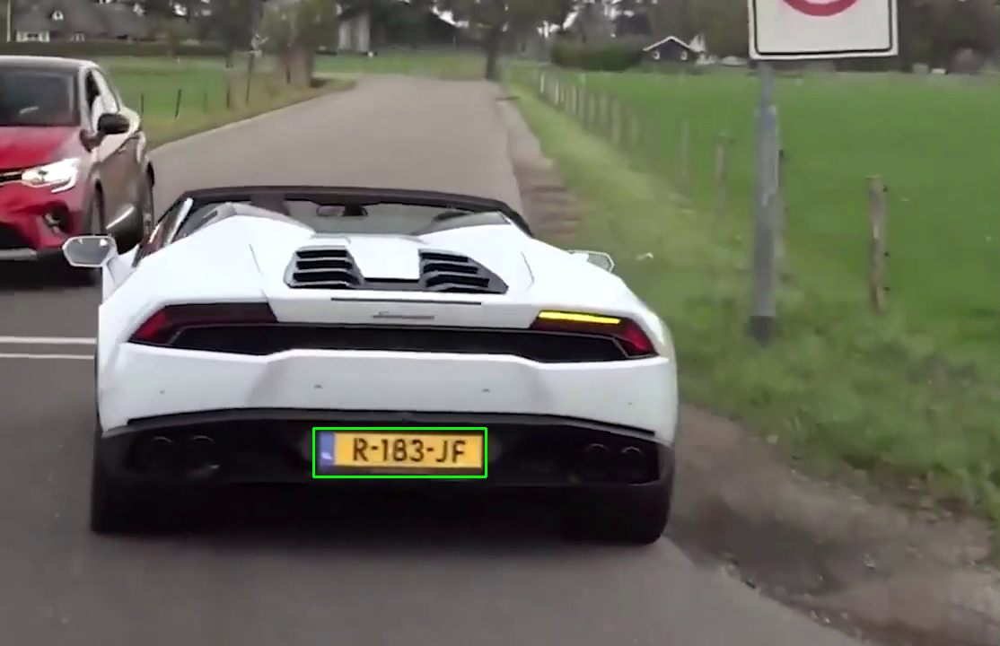


0: 416x640 2 cars, 21.2ms
Speed: 10.2ms preprocess, 21.2ms inference, 6.7ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 29.6ms
Speed: 8.2ms preprocess, 29.6ms inference, 4.5ms postprocess per image at shape (1, 3, 416, 640)


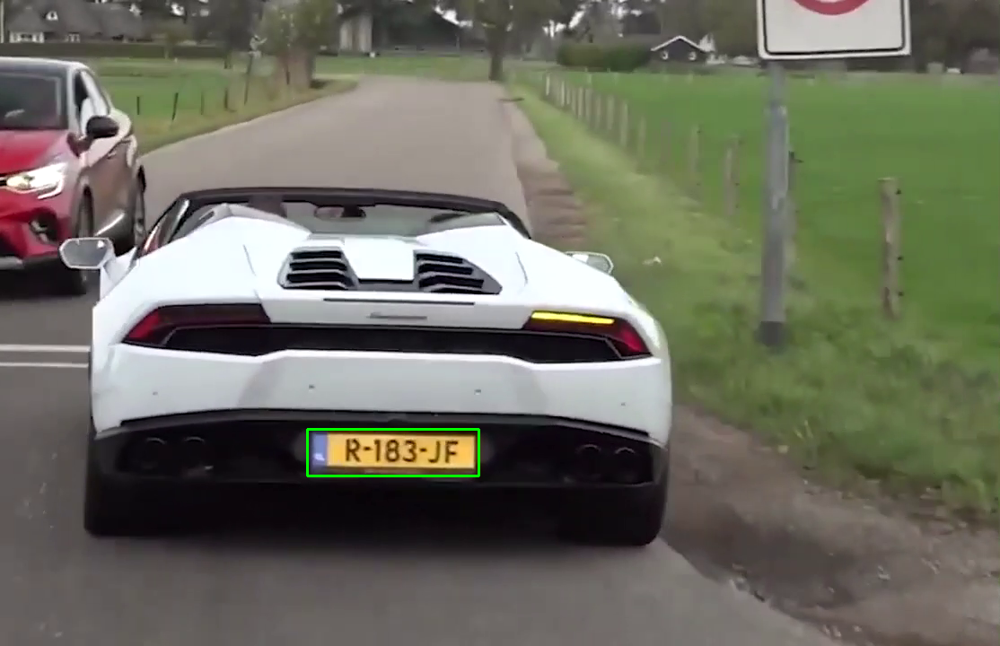


0: 416x640 2 cars, 1 truck, 40.7ms
Speed: 5.5ms preprocess, 40.7ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 22.4ms
Speed: 9.2ms preprocess, 22.4ms inference, 7.7ms postprocess per image at shape (1, 3, 416, 640)


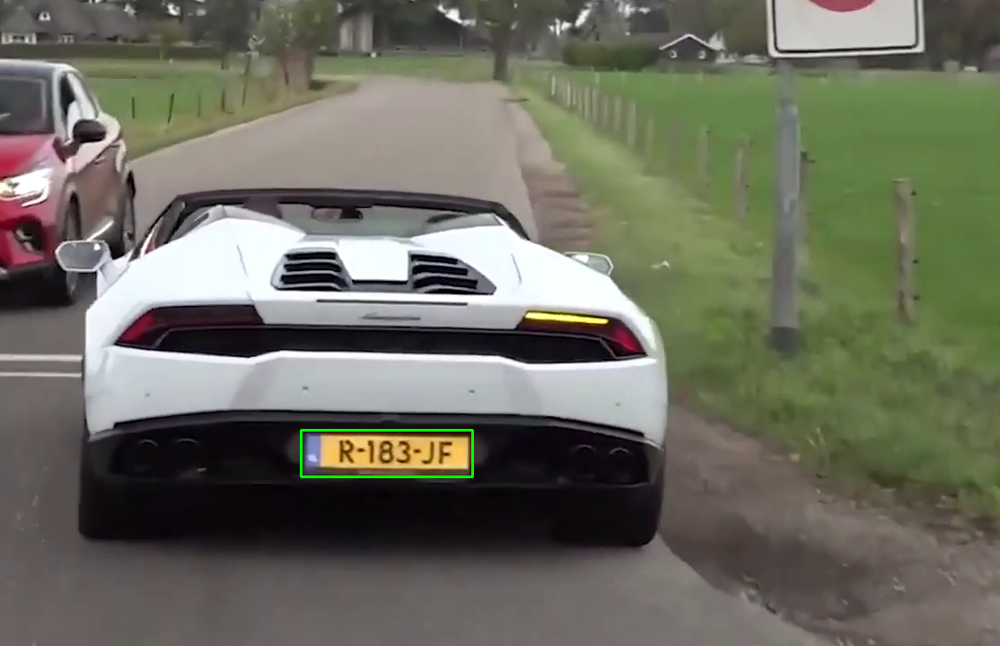


0: 416x640 2 cars, 1 truck, 33.2ms
Speed: 2.9ms preprocess, 33.2ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 36.9ms
Speed: 11.1ms preprocess, 36.9ms inference, 11.7ms postprocess per image at shape (1, 3, 416, 640)


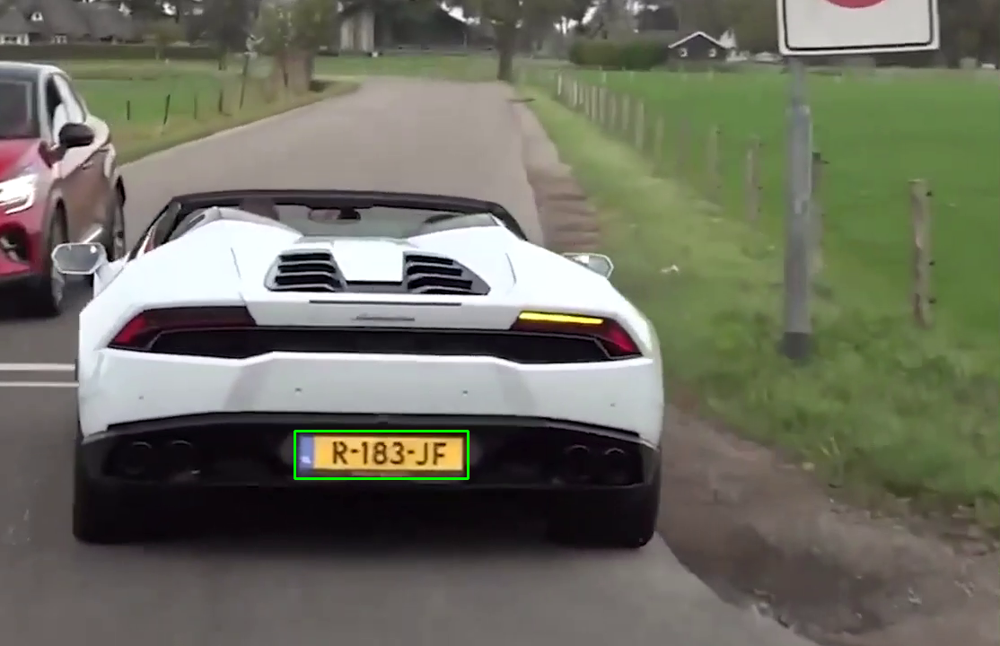


0: 416x640 2 cars, 45.7ms
Speed: 9.6ms preprocess, 45.7ms inference, 8.9ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 27.0ms
Speed: 6.8ms preprocess, 27.0ms inference, 2.5ms postprocess per image at shape (1, 3, 416, 640)


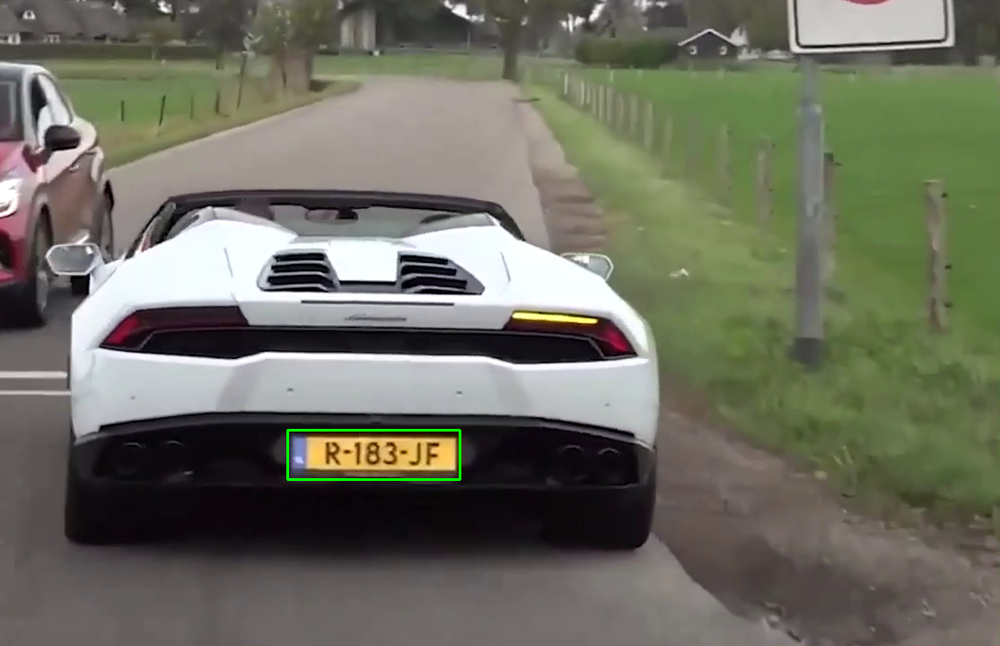


0: 416x640 2 cars, 25.2ms
Speed: 5.6ms preprocess, 25.2ms inference, 7.0ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 29.5ms
Speed: 7.5ms preprocess, 29.5ms inference, 2.1ms postprocess per image at shape (1, 3, 416, 640)


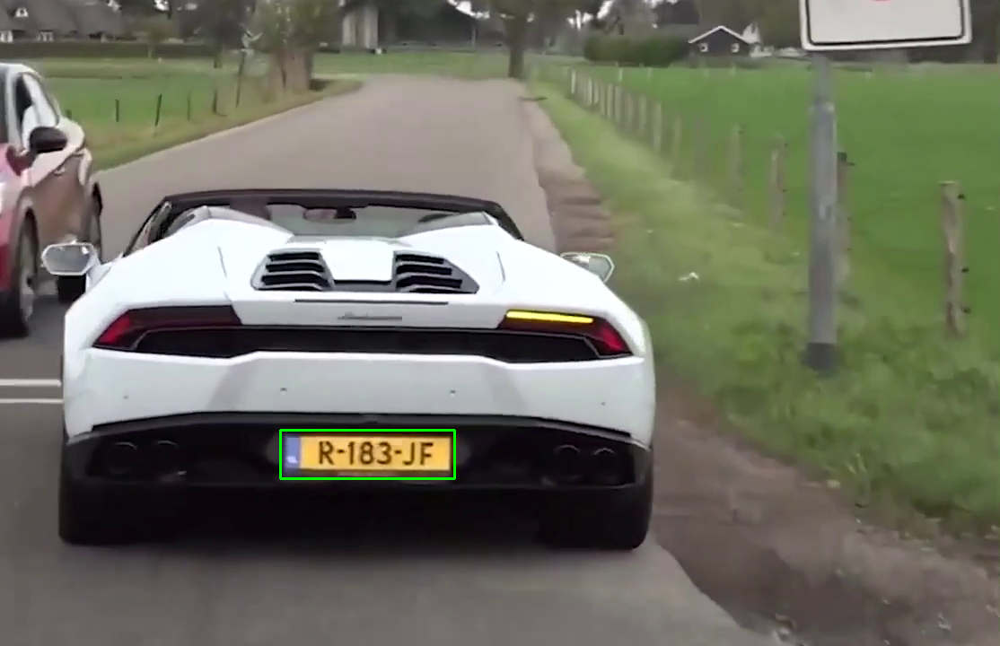


0: 416x640 2 cars, 35.6ms
Speed: 3.4ms preprocess, 35.6ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 26.0ms
Speed: 3.2ms preprocess, 26.0ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 640)


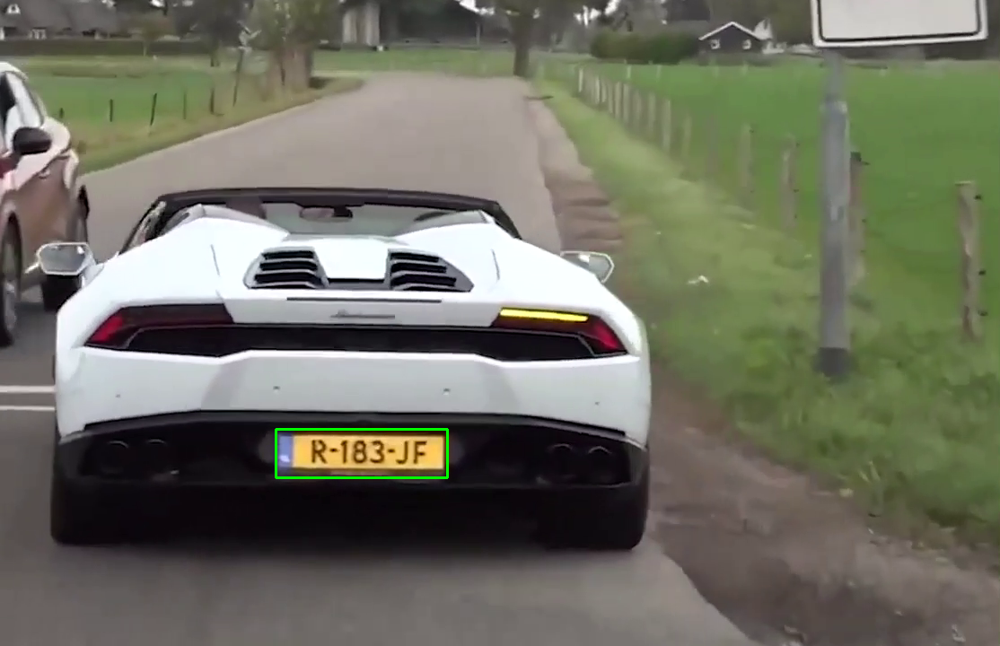


0: 416x640 2 cars, 25.9ms
Speed: 3.2ms preprocess, 25.9ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 28.2ms
Speed: 10.3ms preprocess, 28.2ms inference, 8.6ms postprocess per image at shape (1, 3, 416, 640)


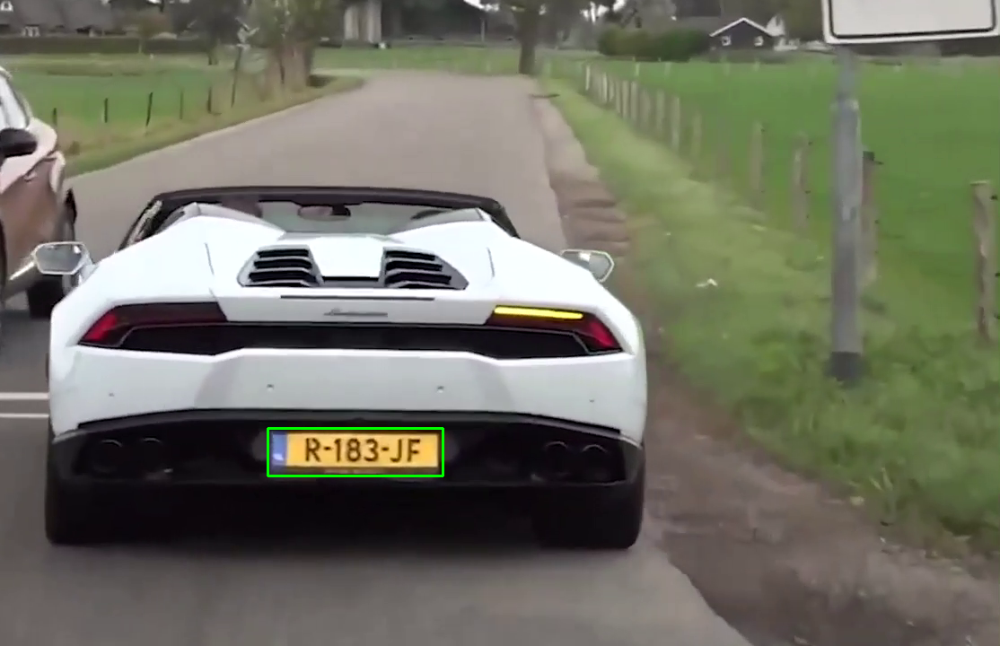


0: 416x640 2 cars, 63.6ms
Speed: 11.0ms preprocess, 63.6ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 60.6ms
Speed: 10.4ms preprocess, 60.6ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)


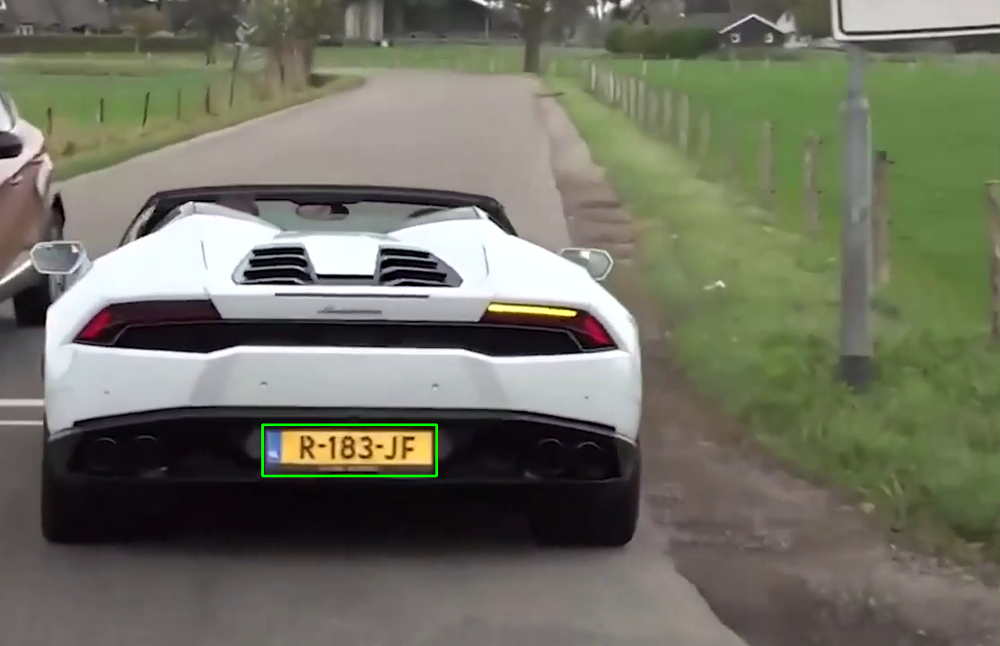


0: 416x640 1 person, 2 cars, 45.6ms
Speed: 19.8ms preprocess, 45.6ms inference, 12.9ms postprocess per image at shape (1, 3, 416, 640)

0: 416x640 1 plaque, 42.0ms
Speed: 3.3ms preprocess, 42.0ms inference, 23.8ms postprocess per image at shape (1, 3, 416, 640)


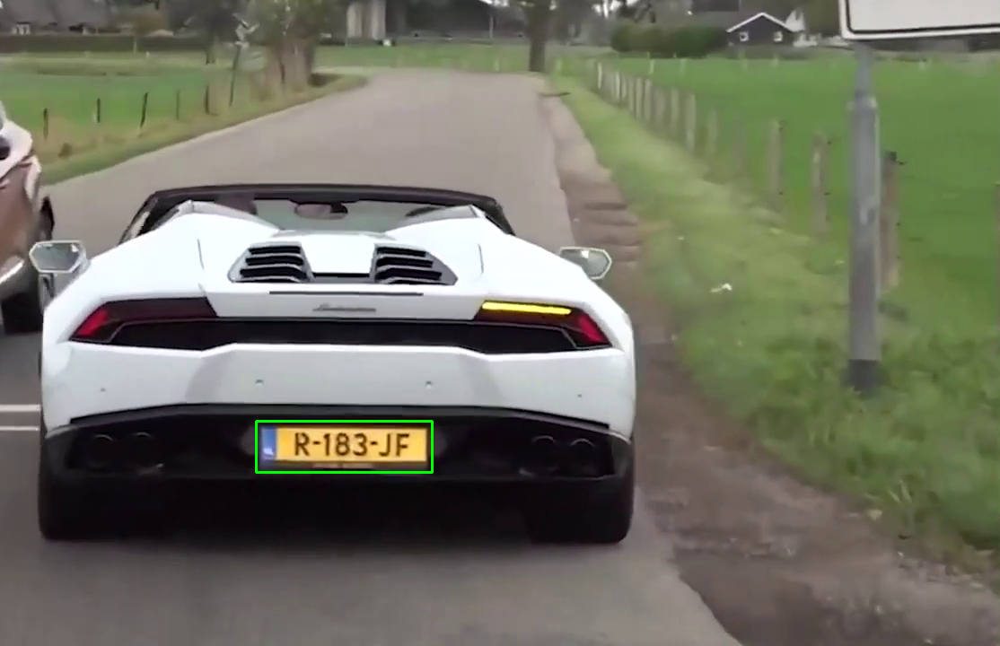

Traitement terminé. Résultats sauvegardés dans /content/drive/MyDrive/results.csv


In [ ]:
# Importer les bibliothèques nécessaires
from ultralytics import YOLO
import supervision as sv
import cv2
import numpy as np
import os
from collections import deque
from google.colab.patches import cv2_imshow
from filterpy.kalman import KalmanFilter
import easyocr
import csv
from scipy.optimize import linear_sum_assignment

# Configurer EasyOCR
reader = easyocr.Reader(['en'], gpu=True)

# Définir les fonctions utilitaires
def write_csv(results: dict, output_path: str) -> None:
    """Sauvegarder les résultats dans un fichier CSV, en ignorant les entrées incomplètes."""
    with open(output_path, 'w', newline='') as csvfile:
        writer = csv.writer(csvfile)
        writer.writerow(['frame_number', 'car_id', 'car_bbox', 'license_plate_bbox',
                         'license_plate_conf_score', 'license_text',
                         'license_plate_text_conf_score'])

        for frame_number, car_id_dict in results.items():
            for car_id, data in car_id_dict.items():
                # Ignorer si 'car' ou 'license_plate' est manquant ou None
                if not data.get('car') or not data.get('license_plate'):
                    continue  # Passer à l'entrée suivante

                car_bbox = data['car']['bbox']
                license_plate = data['license_plate']

                # Vérifier les clés pour la plaque
                license_plate_bbox = license_plate.get('bbox', '')
                license_plate_conf_score = license_plate.get('license_plate_conf_score', 0.0)
                license_text = license_plate.get('license_text', '')
                license_plate_text_conf_score = license_plate.get('license_plate_text_conf_score', 0.0)

                # Écrire les données valides dans le CSV
                writer.writerow([frame_number, car_id, car_bbox, license_plate_bbox,
                                 license_plate_conf_score, license_text,
                                 license_plate_text_conf_score])


def read_license_plate(license_plate_cropped_img):
    """Lire le texte d'une plaque d'immatriculation à l'aide d'EasyOCR."""
    detections = reader.readtext(license_plate_cropped_img, text_threshold=0.8)
    if detections:
        # Extraire le texte et le score de la première détection
        return detections[0][1], detections[0][2]
    return '', 0.0


# Configurer les répertoires de sortie
output_dir = '/content/drive/MyDrive/imagessss'
os.makedirs(output_dir, exist_ok=True)


def main():
    """Fonction principale pour la détection et le suivi."""
    # Charger les modèles YOLO
    license_plate_detector = YOLO("/content/drive/MyDrive/models/best.pt").to('cuda')
    coco_model = YOLO("/content/drive/MyDrive/models/yolov8s.pt").to('cuda')

    # Charger la vidéo
    cap = cv2.VideoCapture("/content/drive/MyDrive/videos/demo.mp4")
    if not cap.isOpened():
        print("Erreur : impossible d'ouvrir la vidéo.")
        return

    # Obtenir des informations sur la vidéo
    fps = int(cap.get(cv2.CAP_PROP_FPS))
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    max_duration_seconds = 1  # Durée maximale à traiter (en secondes)
    max_frames_to_process = min(total_frames, fps * max_duration_seconds)

    print(f"Nombre total de frames : {total_frames}")
    print(f"FPS : {fps}")
    print(f"Frames à traiter : {max_frames_to_process}")

    frame_number = -1
    results = {}

    while frame_number < max_frames_to_process - 1:
        frame_number += 1
        ret, frame = cap.read()
        if not ret:
            print("Fin de la vidéo ou erreur de lecture.")
            break

        # Détection des objets
        detections = coco_model(frame)[0]
        detections = sv.Detections.from_ultralytics(detections)
        byte_tracker = sv.ByteTrack()
        tracks = byte_tracker.update_with_detections(detections)

        # Détection des plaques d'immatriculation
        license_plates = license_plate_detector(frame)

        for license_plate in license_plates[0].boxes.data.tolist():
         x1, y1, x2, y2, conf_score, cls_id = license_plate
         license_plate_crop = frame[int(y1):int(y2), int(x1):int(x2), :]
         cv2.imwrite(f'{output_dir}/frame_{frame_number}_plate_original.jpg', license_plate_crop)

    # Prétraitement et lecture OCR
         gray = cv2.cvtColor(license_plate_crop, cv2.COLOR_BGR2GRAY)
         _, binary = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
         license_plate_text, license_plate_text_conf_score = read_license_plate(binary)

    # Ajouter les résultats seulement si valides
         if int(cls_id) == 0:  # Classe voiture
           results.setdefault(frame_number, {})[cls_id] = {
            'car': {'bbox': f"{x1} {y1} {x2} {y2}"},
            'license_plate': {
                'bbox': f"{x1} {y1} {x2} {y2}",
                'license_plate_conf_score': conf_score,
                'license_text': license_plate_text,
                'license_plate_text_conf_score': license_plate_text_conf_score
            }
        }

        # Afficher les détections
        for license_plate in license_plates[0].boxes.data.tolist():
            x1, y1, x2, y2, conf_score, cls_id = license_plate
            cv2.rectangle(frame, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
        cv2_imshow(frame)

    # Sauvegarder les résultats dans un fichier CSV
    write_csv(results, '/content/drive/MyDrive/results.csv')
    cap.release()
    print("Traitement terminé. Résultats sauvegardés dans /content/drive/MyDrive/results.csv")


# Exécuter le script principal
if __name__ == '__main__':
    main()


In [ ]:
import pandas as pd
results_df = pd.read_csv('/content/drive/MyDrive/results.csv')
print(results_df.head())




   frame_number  car_id                                           car_bbox  \
0             0     0.0  598.6419067382812 524.804931640625 786.1970214...   
1             1     0.0  585.1673583984375 523.7254028320312 774.261413...   
2             2     0.0  569.4451293945312 522.6759033203125 759.730712...   
3             3     0.0  553.7291259765625 520.2418823242188 744.476074...   
4             4     0.0  536.1064453125 519.7467651367188 728.826599121...   

                                  license_plate_bbox  \
0  598.6419067382812 524.804931640625 786.1970214...   
1  585.1673583984375 523.7254028320312 774.261413...   
2  569.4451293945312 522.6759033203125 759.730712...   
3  553.7291259765625 520.2418823242188 744.476074...   
4  536.1064453125 519.7467651367188 728.826599121...   

   license_plate_conf_score license_text  license_plate_text_conf_score  
0                  0.879660      R-183 J                       0.205332  
1                  0.877720      R-193-J      

**input image**

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Image prétraitée :


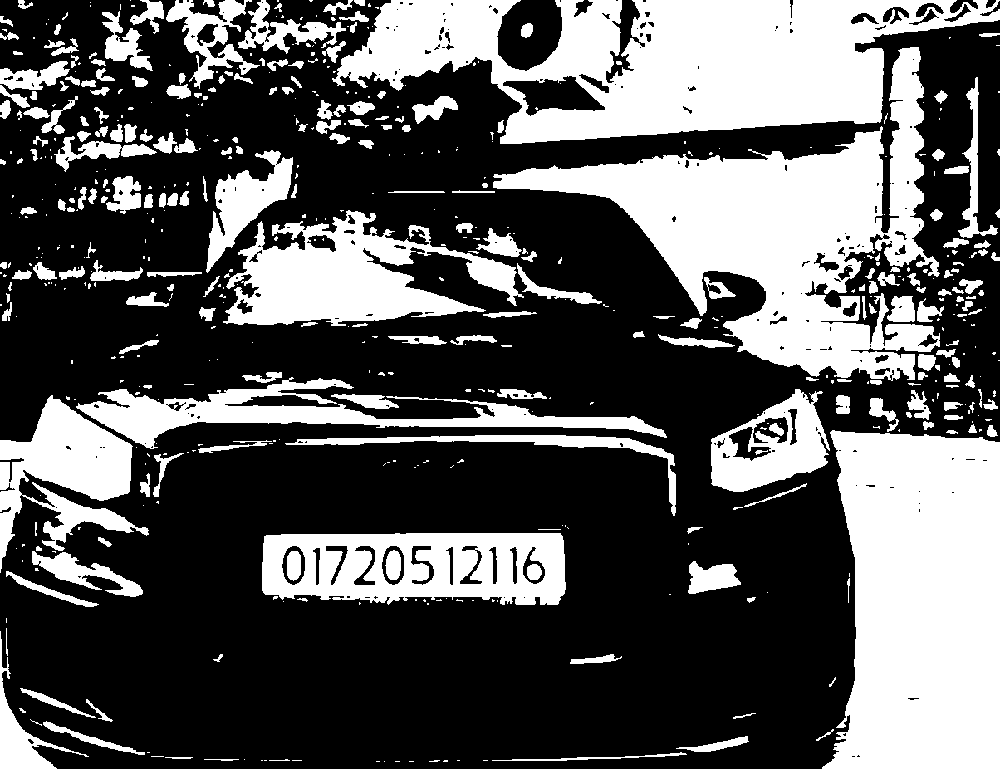

Chiffres extraits de la plaque : 01720512116


In [ ]:
# Installation d'EasyOCR
!pip install easyocr

# Importer les bibliothèques nécessaires
import cv2
import easyocr
import re
from google.colab.patches import cv2_imshow
from google.colab import drive

# Monter Google Drive
drive.mount('/content/drive')

# Initialiser EasyOCR
reader = easyocr.Reader(['en'], gpu=False)

def preprocess_plate(image_path):
    """
    Prétraiter une plaque pour extraire uniquement les chiffres.
    Args:
        image_path: Chemin de l'image contenant la plaque.
    Returns:
        Texte de la plaque contenant uniquement les chiffres.
    """
    # Charger l'image
    image = cv2.imread(image_path)
    if image is None:
        print("Erreur : impossible de charger l'image.")
        return None

    # Convertir en niveaux de gris
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Appliquer un filtre pour réduire le bruit
    blur = cv2.GaussianBlur(gray, (5, 5), 0)

    # Appliquer un seuillage adaptatif pour améliorer le contraste
    thresh = cv2.adaptiveThreshold(
        blur, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 11, 2
    )

    # Trouver les contours pour isoler les régions d'intérêt
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    plate_contour = max(contours, key=cv2.contourArea)

    # Extraire la région de la plaque
    x, y, w, h = cv2.boundingRect(plate_contour)
    plate_roi = image[y:y+h, x:x+w]

    # Redimensionner la région pour améliorer l'OCR
    plate_resized = cv2.resize(plate_roi, None, fx=2, fy=2, interpolation=cv2.INTER_LINEAR)

    # Convertir en niveaux de gris et appliquer un autre seuillage pour la région
    plate_gray = cv2.cvtColor(plate_resized, cv2.COLOR_BGR2GRAY)
    _, plate_thresh = cv2.threshold(plate_gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Afficher le prétraitement
    print("Image prétraitée :")
    cv2_imshow(plate_thresh)

    # Appliquer l'OCR
    results = reader.readtext(plate_thresh)

    # Extraire uniquement les chiffres
    digits = ""
    for (bbox, text, confidence) in results:
        digits += re.sub(r'\D', '', text)  # Supprimer tout sauf les chiffres

    return digits

# Chemin de l'image
image_path = "/content/drive/MyDrive/videos/demoo.jpg"  # Remplacez par le chemin de votre image

# Prétraitement et extraction des chiffres
extracted_digits = preprocess_plate(image_path)
print(f"Chiffres extraits de la plaque : {extracted_digits}")


In [ ]:
from ultralytics import YOLO
import cv2
import numpy as np

# Load the models
vehicle_model = YOLO("/content/drive/MyDrive/models/best.pt")  # Model for vehicle and license plate detection
seatbelt_model = YOLO("/content/drive/MyDrive/YOLOv8Models/best.pt")  # Model for seat belt detection

def detect_and_analyze(image):
    """Detect vehicles and analyze seat belt usage from a single image."""
    results = {}

    # Step 1: Detect vehicles and license plates
    vehicle_detections = vehicle_model.predict(image, verbose=False)[0].boxes.data.cpu().numpy()

    for detection in vehicle_detections:
        x1, y1, x2, y2, conf_score, cls_id = detection
        cls_id = int(cls_id)

        # Process only vehicles
        if cls_id == 0:  # Assuming 0 is the class ID for vehicles
            vehicle_bbox = [int(x1), int(y1), int(x2), int(y2)]
            vehicle_crop = image[int(y1):int(y2), int(x1):int(x2), :]

            # Add vehicle data to results
            vehicle_id = f"vehicle_{len(results)+1}"
            results[vehicle_id] = {
                'bbox': vehicle_bbox,
                'confidence': conf_score,
                'license_plate': None,
                'seat_belt_status': None
            }

            # Step 2: Crop driver's area (assuming left-hand drive)
            driver_area = vehicle_crop[0:int(vehicle_crop.shape[0] * 0.5), 0:int(vehicle_crop.shape[1] * 0.5), :]

            # Step 3: Detect seat belt usage
            seatbelt_detections = seatbelt_model.predict(driver_area, verbose=False)[0].boxes.data.cpu().numpy()

            for sb_detection in seatbelt_detections:
                sb_x1, sb_y1, sb_x2, sb_y2, sb_conf_score, sb_cls_id = sb_detection
                sb_cls_id = int(sb_cls_id)

                # Assuming 0 = No Seat Belt, 1 = Seat Belt
                seat_belt_status = "Wearing Seat Belt" if sb_cls_id == 1 else "No Seat Belt"
                results[vehicle_id]['seat_belt_status'] = {
                    'status': seat_belt_status,
                    'confidence': sb_conf_score,
                    'bbox': [int(sb_x1), int(sb_y1), int(sb_x2), int(sb_y2)]
                }

    return results

# Load your image
image_path = "/content/drive/MyDrive/test_image.jpg"
image = cv2.imread(image_path)

if image is None:
    print("Error: Unable to load the image. Check the path.")
    exit()

# Run detection and analysis
analysis_results = detect_and_analyze(image)

# Visualize results
for vehicle_id, data in analysis_results.items():
    x1, y1, x2, y2 = data['bbox']
    cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
    cv2.putText(image, f"Vehicle: {vehicle_id}", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    if data['seat_belt_status']:
        sb = data['seat_belt_status']
        sb_x1, sb_y1, sb_x2, sb_y2 = sb['bbox']
        sb_status = sb['status']
        sb_conf = sb['confidence']

        cv2.rectangle(image, (sb_x1, sb_y1), (sb_x2, sb_y2), (255, 0, 0), 2)
        cv2.putText(image, f"{sb_status} ({sb_conf:.2f})", (sb_x1, sb_y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

# Display the image
cv2.imshow('Results', image)
cv2.waitKey(0)
cv2.destroyAllWindows()

# Optionally save the output image
output_path = "/content/drive/MyDrive/images/output_image.jpg"
cv2.imwrite(output_path, image)
print(f"Results saved to: {output_path}")


AVEC OCR BON